# Rain prediction in Australia


<img src="../images/1786.webp" height=500 width=700>

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns 
import matplotlib.pyplot as plt
%matplotlib inline
# machine learning
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier


import os



In [2]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler


In [3]:
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score, accuracy_score, confusion_matrix
from sklearn.model_selection import GridSearchCV

***
# Define supporting function
***

In [4]:
def print_results(clf, X_val, y_val):
    """
    Input:
    clf -> trained classifier
    (X_val, y_val) -> validation values
    Output:
    function prints out:
    1. confustion matrix
    2. accuracy score
    3. precision score
    4. recall score
    5. f1 score
    """
    y_pred = clf.predict(X_val)
    print(confusion_matrix(y_val,y_pred), ": is the confustion matrix\n")
    print(accuracy_score(y_val,y_pred), ": is the accuracy score")
    print(precision_score(y_val,y_pred), ": is the precision score")
    print(recall_score(y_val,y_pred), ": is the recall score")
    print(f1_score(y_val,y_pred), ": is the f1 score")


In [5]:
def create_month(df):
    """
    Input:
    df -> DataFrame with column Date
    Output:
    function creates a column with Month removes the Date column 
    """
    df['Month'] = df.Date.apply(lambda x : int(x.split('-')[1]))
    df.drop('Date', axis=1, inplace=True)

In [6]:
def print_missing(df):
    """
    Prints info about missing values
    Input:
    df -> DataFrame
    Output:
    prints out number and percent of missing
    values for numerical columns
    """
    zeros_cnt = df.isnull().sum().sort_values(ascending=False)
    percent_zeros = ( df.isnull().sum() /  df.isnull().count()).sort_values(ascending=False)

    missing_data = pd.concat([zeros_cnt, percent_zeros], axis=1, keys=['Total', 'Percent'])
    print("*"*50)
    print(missing_data)
    print("*"*50)

In [7]:
def fill_missing_values(data, saved_mean):
    """
    Fills missing values for the Test Data
    with values from the provided DataFrame
    'saved_mean"
    Input:
    data -> DataFrame to be imputed
    saved_mean -> DataFrame with saved values
    """

    cols = [cl for cl in data.columns if data[cl].dtype in ['float64']]
    for location in data.Location.unique():
        print("Workin on Location: ", location)
        for month in data.Month.unique():
            for column in cols:
                idx = list(data[(data.Location == location) 
                         & (data.Month == month) 
                         & (data[column].isna())].index)
                fill_value = saved_mean[(saved_mean.Location==location)
                                        & (saved_mean.Month == month)][column]
                #print("Column",column,"Month: ", month, "fill_value ", fill_value )
                data.loc[idx,column] = float(fill_value)
#    return data

In [8]:
def assessClassifier(clf,allValues, random_state=10):
    """
    Function fits classifier 'clf' 
    by using provided values in the
    allValues, calculates appropriate
    scores, and returns the scores as
    a dictionary
    Input:
    clf -> classifier to fit
    allValues -> tuple of the form (X_train, X_val, y_train, y_test)
    Output:
    dictionary of the form:
    {'name':name,'f1':f1, 'precision':precision,'recall':recall,'roc_auc_score':roc_auc_sc,'accuracy':accuracy}
    """
    name = str(clf)
    X_train,X_test,y_train,y_test = allValues
    pipe = Pipeline([(name, clf(random_state=random_state))])
    pipe.fit(X_train,y_train)
    y_pred = pipe.predict(X_test)
    f1 = f1_score(y_test, y_pred)
    precision = precision_score(y_test,y_pred)
    recall = recall_score(y_test,y_pred)
    roc_auc_sc = roc_auc_score(y_test,y_pred)
    accuracy = accuracy_score(y_test,y_pred)
    return {'name':name,'f1':f1, 'precision':precision,'recall':recall,'roc_auc_score':roc_auc_sc,'accuracy':accuracy}

In [9]:
def testClassifier(clf, param_grid, scoring ,values):
    """
    function creates GridSearchCV object,
    fits it on values and prints out 
    the resuls for scores
    Input:
    clf -> classifier to test
    param_grid -> grid of parameters for this clf
    values -> tuple of the type (X_train, X_val, X_test, y_train, y_val, y_test)
    Output:
    prints out the results for
    Training Data,
    Validation Data,
    and Testing Data
    '"""
    X_train, X_val, X_test, y_train, y_val, y_test = values 
    grid = GridSearchCV(clf, param_grid=param_grid, cv=cv,
                                    scoring=scoring,
                            return_train_score=True, verbose=1, n_jobs = -1)
    grid.fit(X_train,y_train)
    print("*"*50)
    print("** Results for Training Data **")
    print("*"*50)
    print_results(grid,X_train,y_train)
    print("*"*50)
    print("** Results for Validation Data **")
    print("*"*50)
    print_results(grid, X_val,y_val)
    print("*"*50)
    print("** Results for Testing Data **")
    print("** not used for training/validation **")
    print("*"*50)
    print_results(grid,X_test,y_test)
    print("*"*50)
    
    return grid

In [10]:
import warnings
warnings.filterwarnings('ignore')

# 1. Load and Research the Data 

In [11]:
df = pd.read_csv('../data/weatherAUS.csv')
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [12]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
Date             145460 non-null object
Location         145460 non-null object
MinTemp          143975 non-null float64
MaxTemp          144199 non-null float64
Rainfall         142199 non-null float64
Evaporation      82670 non-null float64
Sunshine         75625 non-null float64
WindGustDir      135134 non-null object
WindGustSpeed    135197 non-null float64
WindDir9am       134894 non-null object
WindDir3pm       141232 non-null object
WindSpeed9am     143693 non-null float64
WindSpeed3pm     142398 non-null float64
Humidity9am      142806 non-null float64
Humidity3pm      140953 non-null float64
Pressure9am      130395 non-null float64
Pressure3pm      130432 non-null float64
Cloud9am         89572 non-null float64
Cloud3pm         86102 non-null float64
Temp9am          143693 non-null float64
Temp3pm          141851 non-null float64
RainToday        142199 non-null obje

In [14]:
corr_matrix = df.corr()
corr_matrix

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
MinTemp,1.000000,0.736555,0.103938,0.466993,0.072586,0.177415,0.175064,0.175173,-0.232899,0.006089,-0.450970,-0.461292,0.078754,0.021605,0.901821,0.708906
MaxTemp,0.736555,1.000000,-0.074992,0.587932,0.470156,0.067615,0.014450,0.050300,-0.504110,-0.508855,-0.332061,-0.427167,-0.289370,-0.277921,0.887210,0.984503
Rainfall,0.103938,-0.074992,1.000000,-0.064351,-0.227549,0.133659,0.087338,0.057887,0.224405,0.255755,-0.168154,-0.126534,0.198528,0.172403,0.011192,-0.079657
Evaporation,0.466993,0.587932,-0.064351,1.000000,0.365602,0.203021,0.193084,0.129400,-0.504092,-0.390243,-0.270362,-0.293581,-0.183793,-0.182618,0.545115,0.572893
Sunshine,0.072586,0.470156,-0.227549,0.365602,1.000000,-0.034750,0.005499,0.053834,-0.490819,-0.629130,0.041970,-0.019719,-0.675323,-0.703930,0.291188,0.490501
WindGustSpeed,0.177415,0.067615,0.133659,0.203021,-0.034750,1.000000,0.605303,0.686307,-0.215070,-0.026327,-0.458744,-0.413749,0.071736,0.109168,0.150150,0.032748
WindSpeed9am,0.175064,0.014450,0.087338,0.193084,0.005499,0.605303,1.000000,0.519547,-0.270858,-0.031614,-0.228743,-0.175817,0.025112,0.054639,0.128545,0.004569
WindSpeed3pm,0.175173,0.050300,0.057887,0.129400,0.053834,0.686307,0.519547,1.000000,-0.145525,0.016432,-0.296351,-0.255439,0.053337,0.025396,0.163030,0.027778
Humidity9am,-0.232899,-0.504110,0.224405,-0.504092,-0.490819,-0.215070,-0.270858,-0.145525,1.000000,0.666949,0.139442,0.186858,0.452297,0.357326,-0.471354,-0.498399
Humidity3pm,0.006089,-0.508855,0.255755,-0.390243,-0.629130,-0.026327,-0.031614,0.016432,0.666949,1.000000,-0.027544,0.051997,0.517120,0.523120,-0.221019,-0.557841


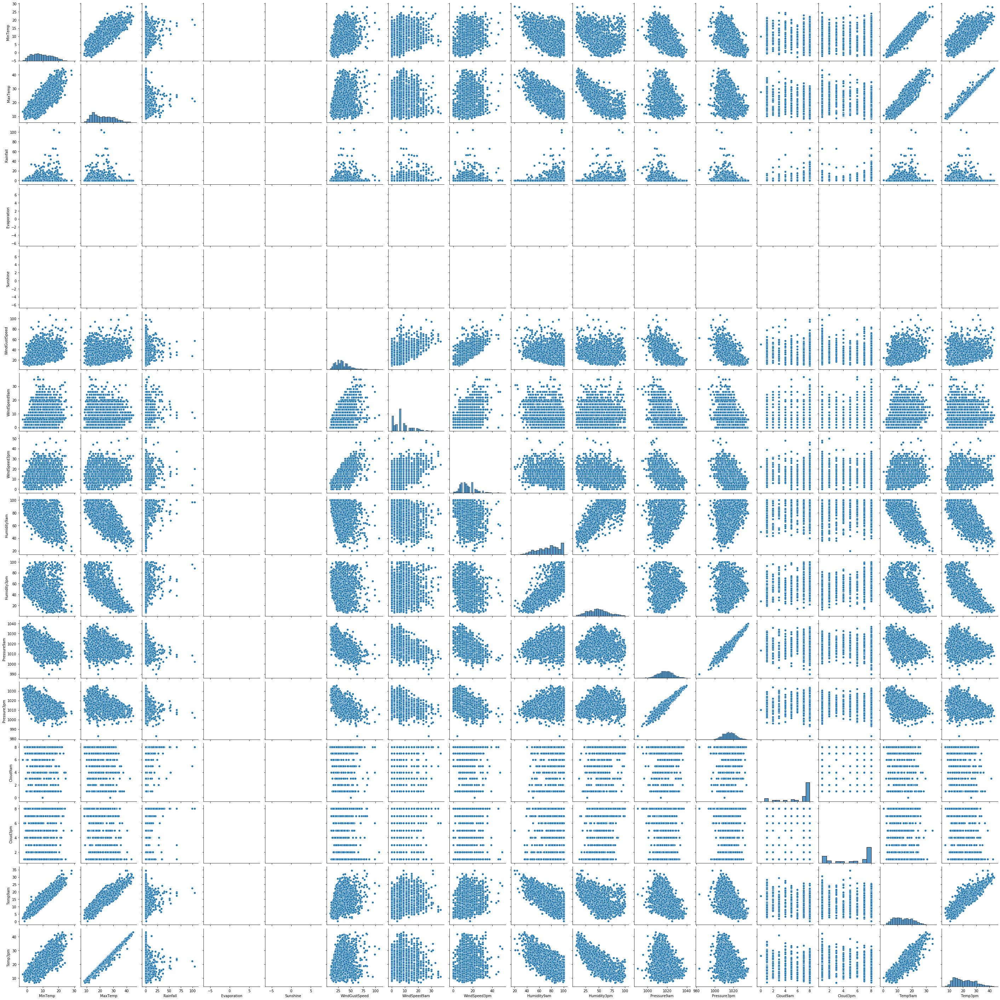

In [15]:
sns.pairplot(df[:2000])

**Comments on the pairplots: There are few linear relations with high values of the r pearson coefficient.**

***
# Split the data to put a test dataset aside  
***

In [16]:
#new_df = df.sample(frac=0.3, random_state=0)
#X = new_df.drop('RainTomorrow',axis=1)
X = df.drop('RainTomorrow',axis=1)
#y = new_df.RainTomorrow
y = df.RainTomorrow
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0) # split the data into train/test datasets

***
# End of Splitting Data
***

***
# Prepare Data 
***

In [17]:
weather_today = X_train.copy()
rain_tomorrow  = y_train.copy()

***
### It seems logical to create a column with the "Month" and drop the column with the "Date". I will call create_month function to do that.
***

In [18]:
create_month(weather_today)
weather_today.head() # Check the result

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
139678,Darwin,23.4,32.8,0.0,5.2,10.9,ESE,35.0,N,W,...,74.0,62.0,1010.1,1007.9,7.0,4.0,29.0,31.4,No,1
137661,AliceSprings,0.6,21.2,0.0,4.4,10.4,ESE,37.0,E,E,...,41.0,15.0,1026.3,1023.6,0.0,1.0,10.1,20.1,No,7
3459,BadgerysCreek,18.3,24.9,0.0,NaN,NaN,E,31.0,SSW,ENE,...,67.0,60.0,1022.2,1021.2,NaN,NaN,19.5,23.9,No,2
58953,Bendigo,13.6,22.0,0.4,4.4,NaN,SW,46.0,WSW,SSW,...,79.0,59.0,1010.1,1012.1,1.0,3.0,17.3,19.6,No,2
3521,BadgerysCreek,4.2,18.4,0.0,NaN,NaN,N,19.0,NNE,WNW,...,96.0,54.0,1020.7,1018.1,NaN,NaN,11.2,17.6,No,4


***
# Dealing with missing values...
### Checking missing values: total and percent
***

In [19]:
print_missing(weather_today) # Print number of missing values together with percent

**************************************************
               Total   Percent
Sunshine       48812  0.479386
Evaporation    43932  0.431459
Cloud3pm       41493  0.407505
Cloud9am       39083  0.383836
Pressure9am    10533  0.103445
Pressure3pm    10509  0.103210
WindDir9am      7336  0.072047
WindGustDir     7206  0.070771
WindGustSpeed   7160  0.070319
Humidity3pm     3135  0.030789
WindDir3pm      2928  0.028756
Temp3pm         2489  0.024445
Rainfall        2257  0.022166
RainToday       2257  0.022166
WindSpeed3pm    2133  0.020948
Humidity9am     1851  0.018179
WindSpeed9am    1226  0.012041
Temp9am         1214  0.011923
MinTemp         1013  0.009949
MaxTemp          882  0.008662
Month              0  0.000000
Location           0  0.000000
**************************************************


***
### There are a lot of missing values in nnunmerical columns. I am going to use the average for this column with the same location and the same month to fill in the missing values. I will, also, create an array called "save" with all the data that is inserted for missing values to use it later for the missing value for the test data that I put aside. "save" array is later converted into a data frame "saved_mean" so it would be easier to use. 
***

In [20]:
save = []
cols = [cl for cl in weather_today.columns if weather_today[cl].dtype in ['float64']] # Numerical Columns
for location in weather_today.Location.unique():
    print(f"Working on Location: {location}")
    for month in weather_today.Month.unique():
        save_info = [location]
        for column in cols:
            mean_for_month = weather_today[(weather_today.Location == location) 
                                           & (weather_today.Month == month)][column].mean()
            if np.isnan(mean_for_month):
                mean_for_month = weather_today[(weather_today.Month == month)][column].mean()
            idx = list(weather_today[(weather_today.Location == location)
                                     & (weather_today.Month == month)
                                     & (weather_today[column].isna())].index)
            weather_today.loc[idx,column] = mean_for_month
            save_info.append(mean_for_month)
        save_info.append(month)
        save.append(save_info)
print_missing(weather_today)# Check if everything worked 

Working on Location: Darwin
Working on Location: AliceSprings
Working on Location: BadgerysCreek
Working on Location: Bendigo
Working on Location: Launceston
Working on Location: Sale
Working on Location: Melbourne
Working on Location: MountGambier
Working on Location: PearceRAAF
Working on Location: NorfolkIsland
Working on Location: Williamtown
Working on Location: GoldCoast
Working on Location: WaggaWagga
Working on Location: Nhil
Working on Location: Brisbane
Working on Location: Moree
Working on Location: Woomera
Working on Location: Newcastle
Working on Location: Townsville
Working on Location: Cobar
Working on Location: Katherine
Working on Location: Wollongong
Working on Location: Nuriootpa
Working on Location: Sydney
Working on Location: Tuggeranong
Working on Location: Dartmoor
Working on Location: Watsonia
Working on Location: NorahHead
Working on Location: Richmond
Working on Location: Adelaide
Working on Location: SydneyAirport
Working on Location: Albury
Working on Locati

In [21]:
weather_today.head() # Check if everything went okay

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
139678,Darwin,23.4,32.8,0.0,5.200000,10.900000,ESE,35.0,N,W,...,74.0,62.0,1010.1,1007.9,7.000000,4.000000,29.0,31.4,No,1
137661,AliceSprings,0.6,21.2,0.0,4.400000,10.400000,ESE,37.0,E,E,...,41.0,15.0,1026.3,1023.6,0.000000,1.000000,10.1,20.1,No,7
3459,BadgerysCreek,18.3,24.9,0.0,7.641079,8.524390,E,31.0,SSW,ENE,...,67.0,60.0,1022.2,1021.2,4.538575,4.443912,19.5,23.9,No,2
58953,Bendigo,13.6,22.0,0.4,4.400000,8.524390,SW,46.0,WSW,SSW,...,79.0,59.0,1010.1,1012.1,1.000000,3.000000,17.3,19.6,No,2
3521,BadgerysCreek,4.2,18.4,0.0,4.523636,7.043027,N,19.0,NNE,WNW,...,96.0,54.0,1020.7,1018.1,4.474599,4.697052,11.2,17.6,No,4


In [22]:
saved_mean = pd.DataFrame(save,columns=['Location']+cols+ ['Month']) # Save the values I used to fill in missing ones for later use as data frame
saved_mean.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Month
0,Darwin,25.211111,31.998485,14.402020,5.553093,5.659898,46.563452,16.368687,22.585859,79.994949,70.489899,1007.672727,1004.959596,6.404040,6.590909,28.398485,30.328788,1
1,Darwin,19.429851,31.441791,0.000995,6.539303,10.291045,40.864322,17.751244,20.368159,56.268657,34.995025,1015.191045,1011.281592,2.497512,2.313433,23.729851,30.247264,7
2,Darwin,25.035119,31.846429,18.675000,5.791195,6.166667,44.053892,15.297619,23.279762,81.357143,69.976190,1008.225595,1005.387500,6.208333,6.190476,28.198810,30.419048,2
3,Darwin,24.443636,33.224242,3.493333,5.918012,8.726061,37.776398,13.787879,18.600000,72.351515,53.521212,1011.544848,1008.196364,4.709091,5.084848,28.113333,31.862424,4
4,Darwin,25.110695,33.618182,6.296257,6.565746,8.311290,39.263736,12.080645,20.005376,70.684492,57.779570,1010.671658,1007.012903,5.000000,4.731183,29.400535,31.955914,11


## Check how balanced the data is for the target column

In [23]:
y_train.value_counts()

No     77213
Yes    22337
Name: RainTomorrow, dtype: int64

## It is not balanced but it is not too bad

# 2. Data preprocessing

In [24]:
num_columns = [column for column in weather_today.columns if weather_today[column].dtype == 'float64'] # Save numerical columns into array so it is easier to use
print(num_columns)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


In [25]:

num_pipline = Pipeline([
    ('std_scaler', StandardScaler()),
]) # Define a pipeline for scaling the data

In [26]:
weather_today[num_columns] = num_pipline.fit_transform(weather_today[num_columns])
weather_today.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
139678,Darwin,1.754706,1.351530,-0.282029,-0.062824,1.137323,ESE,-0.386492,N,W,...,0.264815,0.498841,-1.108446,-1.092306,1.045178,-0.266892,1.855627,1.398528,No,1
137661,AliceSprings,-1.815371,-0.281661,-0.282029,-0.288151,0.963790,ESE,-0.234318,E,E,...,-1.484586,-1.784707,1.274818,1.242221,-1.964060,-1.667714,-1.054801,-0.228481,No,7
3459,BadgerysCreek,0.956136,0.239271,-0.282029,0.624727,0.312830,E,-0.690839,SSW,ENE,...,-0.106270,0.401669,0.671646,0.885350,-0.012967,-0.059611,0.392713,0.318655,No,2
58953,Bendigo,0.220199,-0.169027,-0.234717,-0.288151,0.312830,SW,0.450462,WSW,SSW,...,0.529876,0.353083,-1.108446,-0.467783,-1.534169,-0.733832,0.053933,-0.300472,No,2
3521,BadgerysCreek,-1.251674,-0.675880,-0.282029,-0.253328,-0.201300,N,-1.603879,NNE,WNW,...,1.431083,0.110152,0.450973,0.424393,-0.040470,0.058591,-0.885411,-0.588439,No,4


***
## Let's encode categorical features using one-hot-encoding.
***

In [27]:
ohe = pd.get_dummies(data=weather_today, columns=['WindGustDir','WindDir9am','WindDir3pm','Location'],drop_first=True)
ohe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101822 entries, 139678 to 43567
Columns: 111 entries, MinTemp to Location_Woomera
dtypes: float64(16), int64(1), object(1), uint8(93)
memory usage: 28.8+ MB


In [28]:
from sklearn import preprocessing

ohe['RainToday'] = weather_today['RainToday'].astype(str)
ohe['RainTomorrow'] =rain_tomorrow.astype(str)

lb = preprocessing.LabelBinarizer()

ohe['RainToday'] = lb.fit_transform(ohe['RainToday'])
ohe['RainTomorrow'] = lb.fit_transform(ohe['RainTomorrow'])

**Drop missing values and create target column y and data X**

In [29]:
ohe = ohe.dropna()
y = ohe['RainTomorrow']
X = ohe.drop(['RainTomorrow'], axis=1)

In [30]:
X.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Location_Townsville,Location_Tuggeranong,Location_Uluru,Location_WaggaWagga,Location_Walpole,Location_Watsonia,Location_Williamtown,Location_Witchcliffe,Location_Wollongong,Location_Woomera
139678,1.754706,1.351530,-0.282029,-0.062824,1.137323,-0.386492,0.108842,-0.416237,0.264815,0.498841,...,0,0,0,0,0,0,0,0,0,0
137661,-1.815371,-0.281661,-0.282029,-0.288151,0.963790,-0.234318,-0.568259,0.612581,-1.484586,-1.784707,...,0,0,0,0,0,0,0,0,0,0
3459,0.956136,0.239271,-0.282029,0.624727,0.312830,-0.690839,-0.568259,-0.416237,-0.106270,0.401669,...,0,0,0,0,0,0,0,0,0,0
58953,0.220199,-0.169027,-0.234717,-0.288151,0.312830,0.450462,0.334542,0.383954,0.529876,0.353083,...,0,0,0,0,0,0,0,0,0,0
3521,-1.251674,-0.675880,-0.282029,-0.253328,-0.201300,-1.603879,-0.793959,-1.445054,1.431083,0.110152,...,0,0,0,0,0,0,0,0,0,0


In [31]:
y.head()

139678    1
137661    1
3459      1
58953     1
3521      1
Name: RainTomorrow, dtype: int64

***
## Split the data into the training and validation parts
***

In [32]:
X_train,X_val,y_train,y_val = train_test_split(X, y, test_size=0.3,random_state=0) 
allValues = (X_train,X_val,y_train,y_val) # Create a tuple to send it as an argument to the function

***
## Here I preprocess the Test Data that will not be used for training but will be used at the end to test how well our model performs
***

In [33]:
X_test.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
138175,2014-12-03,AliceSprings,21.9,39.4,1.6,11.2,11.5,NNW,57.0,NE,...,33.0,50.0,26.0,1008.5,1004.1,2.0,6.0,29.8,35.4,Yes
38638,2015-01-08,WaggaWagga,20.5,37.5,0.0,9.2,8.4,WNW,59.0,ENE,...,20.0,47.0,22.0,1012.9,1006.5,4.0,7.0,27.3,35.7,No
124058,2009-08-16,SalmonGums,5.1,17.2,0.2,NaN,NaN,W,50.0,WNW,...,22.0,68.0,51.0,NaN,NaN,NaN,NaN,10.1,16.1,No
99214,2016-08-31,Adelaide,11.9,16.8,1.0,NaN,NaN,SW,28.0,WNW,...,13.0,80.0,79.0,1018.5,1017.7,NaN,NaN,14.3,15.2,No
25097,2011-08-28,Penrith,7.5,21.3,0.0,NaN,NaN,NE,15.0,SW,...,7.0,88.0,52.0,NaN,NaN,NaN,NaN,13.7,21.1,No


In [34]:
print_missing(X_test)

**************************************************
               Total   Percent
Sunshine       21023  0.481759
Evaporation    18858  0.432146
Cloud3pm       17865  0.409391
Cloud9am       16805  0.385100
Pressure9am     4532  0.103854
Pressure3pm     4519  0.103557
WindDir9am      3230  0.074018
WindGustDir     3120  0.071497
WindGustSpeed   3103  0.071108
Humidity3pm     1372  0.031440
WindDir3pm      1300  0.029791
Temp3pm         1120  0.025666
Rainfall        1004  0.023007
RainToday       1004  0.023007
WindSpeed3pm     929  0.021289
Humidity9am      803  0.018401
Temp9am          553  0.012672
WindSpeed9am     541  0.012397
MinTemp          472  0.010816
MaxTemp          379  0.008685
Location           0  0.000000
Date               0  0.000000
**************************************************


In [35]:
create_month(X_test) # Create Month column and frop the Date column 

In [36]:
fill_missing_values(X_test, saved_mean) # Fill in missing values by using previously saved ones in "saved_mean"

Workin on Location:  AliceSprings
Workin on Location:  WaggaWagga
Workin on Location:  SalmonGums
Workin on Location:  Adelaide
Workin on Location:  Penrith
Workin on Location:  PearceRAAF
Workin on Location:  NorfolkIsland
Workin on Location:  Sydney
Workin on Location:  Albany
Workin on Location:  Perth
Workin on Location:  Richmond
Workin on Location:  Wollongong
Workin on Location:  Cobar
Workin on Location:  Witchcliffe
Workin on Location:  Cairns
Workin on Location:  Sale
Workin on Location:  Tuggeranong
Workin on Location:  MelbourneAirport
Workin on Location:  GoldCoast
Workin on Location:  Katherine
Workin on Location:  Nuriootpa
Workin on Location:  Melbourne
Workin on Location:  Canberra
Workin on Location:  NorahHead
Workin on Location:  Woomera
Workin on Location:  Williamtown
Workin on Location:  Ballarat
Workin on Location:  Mildura
Workin on Location:  Launceston
Workin on Location:  Hobart
Workin on Location:  Uluru
Workin on Location:  Bendigo
Workin on Location:  Wat

In [37]:
X_test.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
138175,AliceSprings,21.9,39.4,1.6,11.200000,11.500000,NNW,57.0,NE,N,...,50.0,26.0,1008.500000,1004.100000,2.000000,6.000000,29.8,35.4,Yes,12
38638,WaggaWagga,20.5,37.5,0.0,9.200000,8.400000,WNW,59.0,ENE,N,...,47.0,22.0,1012.900000,1006.500000,4.000000,7.000000,27.3,35.7,No,1
124058,SalmonGums,5.1,17.2,0.2,3.589293,7.178311,W,50.0,WNW,W,...,68.0,51.0,1019.576378,1016.961058,4.237801,4.468109,10.1,16.1,No,8
99214,Adelaide,11.9,16.8,1.0,2.627451,5.574510,SW,28.0,WNW,SW,...,80.0,79.0,1018.500000,1017.700000,4.211687,4.441124,14.3,15.2,No,8
25097,Penrith,7.5,21.3,0.0,3.602077,7.189200,NE,15.0,SW,NNE,...,88.0,52.0,1019.572711,1016.957985,4.231839,4.456196,13.7,21.1,No,8


In [38]:
ohe = pd.get_dummies(data=X_test, columns=['WindGustDir','WindDir9am','WindDir3pm','Location'],drop_first=True) # Transform String columns
ohe['RainToday'] = X_test['RainToday'].astype(str)
ohe['RainTomorrow'] =y_test.astype(str)
ohe['RainToday'] = lb.transform(ohe['RainToday']) # use fitted LabelBinarizer to transform column
ohe['RainTomorrow'] = lb.transform(ohe['RainTomorrow'])
ohe = ohe.dropna()
y_test = ohe['RainTomorrow']
X_test = ohe.drop(['RainTomorrow'], axis=1)

In [39]:
X_test[num_columns] = num_pipline.transform(X_test[num_columns]) # use fitted pipeline to transform numerical columns
X_test[num_columns].head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
138175,1.519833,2.280760,-0.092781,1.627128,1.345562,1.287417,0.673093,1.641398,-1.007477,-1.250260,-1.343831,-1.657351,-1.104278,0.666990,1.978819,1.974461
38638,1.300617,2.013254,-0.282029,1.063810,0.269659,1.439590,0.334542,0.155328,-1.166513,-1.444604,-0.696524,-1.300480,-0.244495,1.133931,1.593842,2.017655
124058,-1.110750,-0.844831,-0.258373,-0.516494,-0.154347,0.754809,1.575894,0.383954,-0.053258,-0.035606,0.285671,0.255037,-0.142267,-0.048312,-1.054801,-0.804413
99214,-0.045991,-0.901148,-0.163749,-0.787405,-0.710971,-0.919099,-0.342559,-0.644863,0.582888,1.324805,0.127320,0.364914,-0.153493,-0.060913,-0.408039,-0.933998
25097,-0.734953,-0.267582,-0.282029,-0.512893,-0.150568,-1.908226,-1.358210,-1.330741,1.006986,0.012980,0.285132,0.254580,-0.144830,-0.053875,-0.500434,-0.084498


# 3. Model building

In [40]:
clf_Logistic = LogisticRegression()
clf_Forest = RandomForestClassifier()
clf_KNN = KNeighborsClassifier()
clf_SVC = SVC()
clf_XGBoost = XGBClassifier()
clf_NaiveB = GaussianNB()

In [41]:
details = {'name':[],'f1':[],'precision':[],'recall':[],'roc_auc_score':[], 'accuracy':[]}
classifiers = [clf_Logistic, clf_Forest,clf_KNN,clf_SVC, clf_XGBoost, clf_NaiveB]
for clf in classifiers:#, clf_KNN,clf_SVC, clf_XGBoost, clf_NaiveB]:
    print(f"Working on {str(clf)}")
    results = assessClassifier(clf, allValues)
    for item in results.keys():
        details[item].append(results[item])

Working on LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
Working on RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)
Working on KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     

In [42]:
df = pd.DataFrame(details)
df

,name,f1,precision,recall,roc_auc_score,accuracy
0,"LogisticRegression(C=1.0, class_weight=None, d...",0.895029,0.857409,0.936103,0.725266,0.833732
1,"RandomForestClassifier(bootstrap=True, ccp_alp...",0.902969,0.860816,0.949462,0.735316,0.845484
2,"KNeighborsClassifier(algorithm='auto', leaf_si...",0.885957,0.851695,0.923090,0.710871,0.820048
3,"SVC(C=1.0, break_ties=False, cache_size=200, c...",0.901867,0.851384,0.958713,0.718367,0.842014
4,"XGBClassifier(base_score=None, booster=None, c...",0.903930,0.870828,0.939648,0.752456,0.848758
5,"GaussianNB(priors=None, var_smoothing=1e-09)",0.744316,0.868805,0.651031,0.672198,0.661309


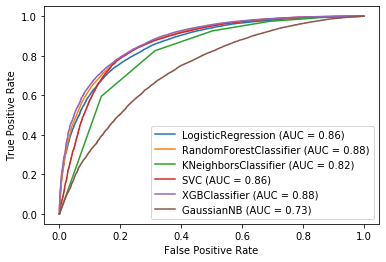

In [43]:
from sklearn.metrics import plot_roc_curve
ax = plt.gca()
for clf in classifiers:
    plot_roc_curve(clf, X_test, y_test, ax=ax)
plt.show()

***
#  Comments on Vanilla Classifiers 
### I will use Logistic Regression, XGBClassifier, and GaussinanNB Classifiers for tune ups and comparison
***

In [57]:
cv = 5
scoring = 'f1'
values = (X_train, X_val, X_test, y_train, y_val, y_test)
random_state =10

# 4. Tune up models

***
## Tune up Logistic Regression
***

In [60]:
c_space = np.logspace(-10, 18, 30)
param_grid_LG = {'C': c_space,
    'penalty': ['l1', 'l2'],
    'max_iter': [100,500],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']}

In [61]:
logistic = testClassifier(LogisticRegression(random_state=random_state), param_grid=param_grid_LG, scoring=scoring, values=values)

Fitting 5 folds for each of 600 candidates, totalling 3000 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 160 tasks      | elapsed:   17.5s
[Parallel(n_jobs=-1)]: Done 410 tasks      | elapsed:   32.7s
[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:   48.9s
[Parallel(n_jobs=-1)]: Done 1210 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done 1760 tasks      | elapsed:  8.2min
[Parallel(n_jobs=-1)]: Done 2410 tasks      | elapsed: 14.5min
[Parallel(n_jobs=-1)]: Done 3000 out of 3000 | elapsed: 20.9min finished
**************************************************
** Results for Training Data **
**************************************************
[[ 8839  8354]
 [ 3394 50688]] : is the confustion matrix

0.8351736232900736 : is the accuracy score
0.8585075031333627 : is the precision score
0.9372434451388633 : is the recall score
0.8961493582263711 : is the 

***
## Tune up Random Forest
***

In [65]:
param_grid_rf = [{'bootstrap':[True],'n_estimators':[3,5,10,20,30,50,80,120],
    'max_features':['auto'],
    'max_depth' : [5,10,20, 30, 40, 50 ,60 , 70],
    'criterion':['gini', 'entropy']},]
random_forest = testClassifier(RandomForestClassifier(random_state=random_state), param_grid=param_grid_rf, scoring=scoring, values=values)

Fitting 5 folds for each of 128 candidates, totalling 640 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 160 tasks      | elapsed:   40.5s
[Parallel(n_jobs=-1)]: Done 410 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done 640 out of 640 | elapsed:  3.9min finished
**************************************************
** Results for Training Data **
**************************************************
[[17192     1]
 [    0 54082]] : is the confustion matrix

0.9999859698351455 : is the accuracy score
0.9999815099014477 : is the precision score
1.0 : is the recall score
0.9999907548652521 : is the f1 score
**************************************************
** Results for Validation Data **
**************************************************
[[ 3825  3591]
 [ 1163 21968]] : is the confustion matrix

0.8443709693259567 : is the accuracy score
0.8595015454438749 : i

***
# HGBoost Tune Up
***

In [53]:
param_grid_xgb = {
    'max_depth':range(2,10,1),
    'n_estimators': range(20,100,20),
    'learning_rate': [0.1, 0.01, 0.05]
}
xgboost = testClassifier(XGBClassifier(random_state=random_state),
                        param_grid=param_grid_xgb,
                        scoring=scoring,
                        values=values)

Fitting 5 folds for each of 96 candidates, totalling 480 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  1.3min


KeyboardInterrupt: 

***
# Tune up Support Vector Machines
***

In [ ]:
Cs = [0.1 ,1, 5, 10, 30, 50, 70, 100]
#Cs = [0.001, 0.1 ,1, 100, 10000]
gammas = [0.0001, 0.001, 0.01, 0.1 , 1, 3, 5, 10]
#gammas = [ 1,2,7,8,9,10,11,12,13]
param_grid_SVC = {'C':Cs, 'gamma':gammas }
param_grid_SVC = { 'C':[0.1,1,100,1000],'kernel':['rbf','poly','sigmoid','linear'],'degree':[1,2,3,4,5,6],'gamma': [1, 0.1, 0.01, 0.001, 0.0001]}
svc = testClassifier(SVC(random_state=random_state),
                    param_grid=param_grid_SVC,
                    scoring=scoring,
                    values=values)

***
## Now I will identify the threshold's influence on the scores
***

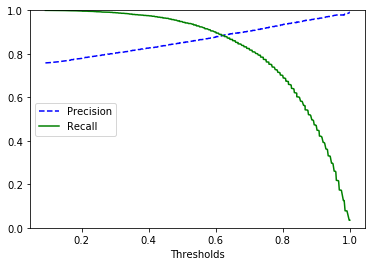

In [52]:
from sklearn.metrics import precision_recall_curve
clf = random_forest
y_scores = clf.predict_proba(X_test)[:,1]
#y_scores

precisions, recalls, thresholds = precision_recall_curve(y_test, y_scores)

def plot_prc (precisions, recalls, thresholds):
    plt.plot(thresholds, precisions[:-1], 'b--', label='Precision')
    plt.plot(thresholds, recalls[:-1], 'g-', label='Recall')
    plt.xlabel('Thresholds')
    plt.legend(loc='center left')
    plt.ylim([0,1])

plot_prc(precisions, recalls, thresholds)

In [ ]:
y_pred1 = (clf.predict_proba(X_test)[:,1] >= 0.75).astype(int) # set threshold
print(precision_score(y_test, y_pred1))
print(f1_score(y_test,y_pred1))
